In [1]:
import cv2
import os
import random
import numpy as np
import pandas as pd

import matplotlib
import matplotlib.pyplot as plt
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision

from data_helper import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

# All the images are saved in image_folder
# All the labels are saved in the annotation_csv file
image_folder = 'data'
annotation_csv = 'data/annotation.csv'
# You shouldn't change the unlabeled_scene_index
# The first 106 scenes are unlabeled
unlabeled_scene_index = np.arange(106)
# The scenes from 106 - 133 are labeled
# You should devide the labeled_scene_index into two subsets (training and validation)
labeled_scene_index = np.arange(106, 134)


NUM_SAMPLE_PER_SCENE = 126
NUM_IMAGE_PER_SAMPLE = 6
image_names = [
    'CAM_FRONT_LEFT.jpeg',
    'CAM_FRONT.jpeg',
    'CAM_FRONT_RIGHT.jpeg',
    'CAM_BACK_LEFT.jpeg',
    'CAM_BACK.jpeg',
    'CAM_BACK_RIGHT.jpeg',
    ]

from PIL import Image

from skimage.color import lab2rgb, rgb2lab, rgb2gray
import copy, time

In [2]:
class GrayDataset(torch.utils.data.Dataset):
    def __init__(self, image_folder, scene_index, transform, train = True):
        self.image_folder = image_folder
        self.scene_index = scene_index
        self.transform = transform
        self.first_dim = 'image'
        self.is_training = train
        np.random.seed(1)
    def __len__(self):
        return self.scene_index.size * NUM_SAMPLE_PER_SCENE * NUM_IMAGE_PER_SAMPLE
    
    def __getitem__(self, index):
        scene_id = self.scene_index[index//(NUM_SAMPLE_PER_SCENE * NUM_IMAGE_PER_SAMPLE)]
        sample_id = (index % (NUM_SAMPLE_PER_SCENE*NUM_IMAGE_PER_SAMPLE)) // NUM_IMAGE_PER_SAMPLE
        image_name = image_names[index % NUM_IMAGE_PER_SAMPLE]
        
        image_path = os.path.join(self.image_folder, f'scene_{scene_id}', f'sample_{sample_id}', image_name) 
            
        image = Image.open(image_path) 
        image_original = self.transform(image)# image original 3x256x306
        
        # Starting conversion
        image_original = image_original.numpy().transpose(1,2,0)
        image_lab = rgb2lab(image_original)
        #image_lab = (image_lab+128)/255
        image_ab = image_lab[:, :, 1:3]
        image_ab = torch.from_numpy(image_ab.transpose((2,0,1))).float()
        image_original = rgb2gray(image_original)
        image_original = torch.from_numpy(image_original).unsqueeze(0).float()
        
        return image_original, image_ab
     

In [3]:
transform = torchvision.transforms.Compose([torchvision.transforms.ToTensor()])

BATCH_SIZE=1
random.seed(1008)
random.shuffle(unlabeled_scene_index)
train_scene = unlabeled_scene_index[:85]
val_scene = unlabeled_scene_index[85:]

train_set = GrayDataset(image_folder = image_folder, scene_index= train_scene,
                        transform = transform, train=True)
val_set = GrayDataset(image_folder=image_folder, scene_index=  val_scene, 
                        transform = transform, train=False)

train_loader = torch.utils.data.DataLoader(train_set, batch_size= BATCH_SIZE, 
                                           shuffle=True, num_workers=2)
val_loader = torch.utils.data.DataLoader(val_set, batch_size= BATCH_SIZE, 
                                           shuffle=True, num_workers=2)

In [4]:
def to_rgb(grayscale_input, ab_input):
    '''
    input in shape torch tensoir CxHx W
    '''
    color_image = torch.cat((grayscale_input, ab_input), 0).numpy().transpose(1,2,0)
    color_image[:, :, 0:1] = color_image[:, :, 0:1] * 100
    color_image = lab2rgb(color_image.astype(np.float64))
    return color_image # returns a numpy array in shape h x w x 3


In [6]:
gray_image, image_ab = iter(train_loader).next()


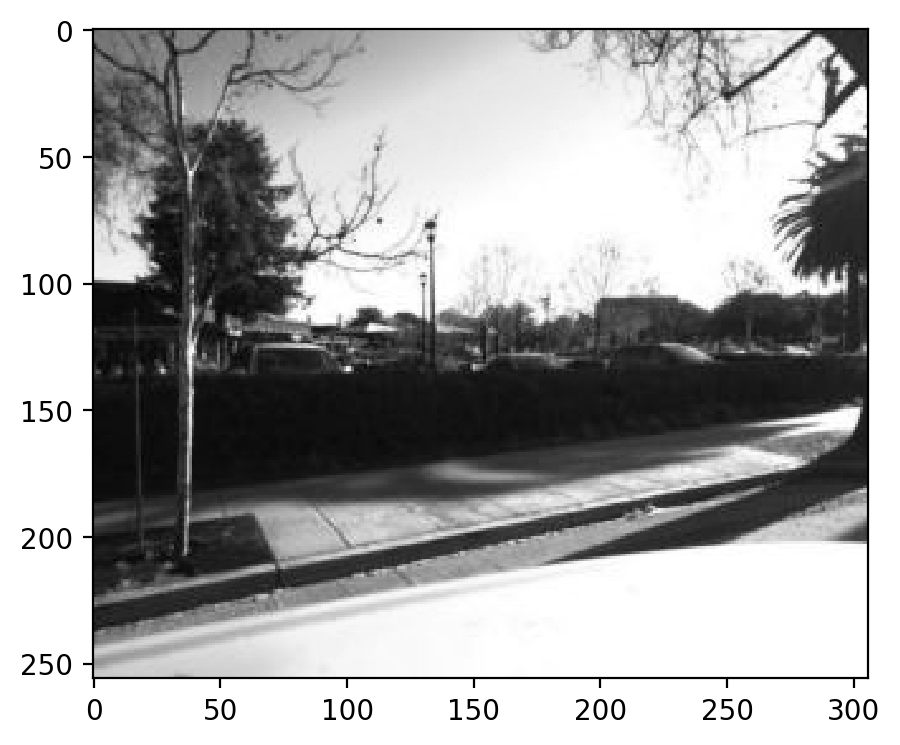

In [8]:
plt.imshow(gray_image.squeeze().cpu(), cmap = 'gray')

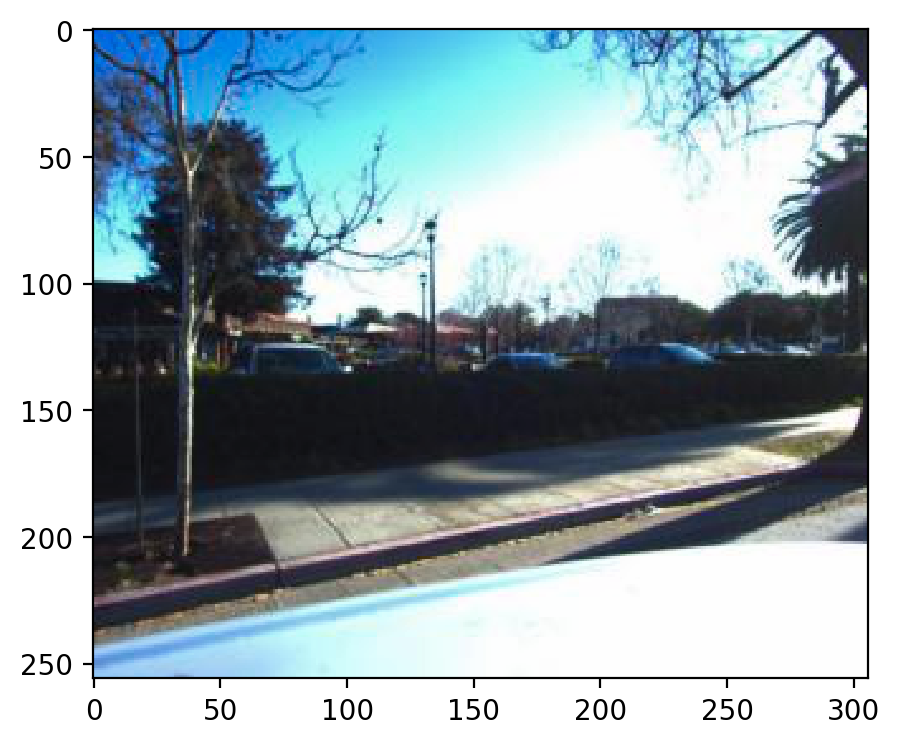

In [14]:
colored = to_rgb(gray_image.squeeze(0).cpu(), image_ab.squeeze(0).cpu())
plt.imshow(colored)

In [5]:
class color_encoder(nn.Module):
    def __init__(self):
        super(color_encoder, self).__init__()
        encoder = torchvision.models.resnet50(pretrained=False)
        encoder = list(encoder.children())[1:-3]
        encoder = [nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)] + encoder
        self.encoder = nn.Sequential(*encoder)
        
    def forward(self, x):
        x = self.encoder(x)
        return x 

In [16]:
temp_encoder= color_encoder()

In [19]:
test_output = temp_encoder(gray_image)

In [6]:
class _SameDecoder(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, num_layers, out_activation = 'relu'):
        super(_SameDecoder, self).__init__()
        layers = [
            nn.ConvTranspose2d(in_channels, in_channels, kernel_size=kernel_size, stride=stride),
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ]
        layers += [
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True) 
        ]*(num_layers-2)
        
        layers += [
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True) if out_activation == 'relu' else nn.Sigmoid(),
        ]
        self.decode = nn.Sequential(*layers)
    def forward(self, x):
        return self.decode(x)
def get_upsampling_weight(in_channels, out_channels, kernel_size):
    """Make a 2D bilinear kernel suitable for upsampling"""
    factor = (kernel_size + 1) // 2
    if kernel_size % 2 == 1:
        center = factor - 1
    else:
        center = factor - 0.5
    og = np.ogrid[:kernel_size, :kernel_size]
    filt = (1 - abs(og[0] - center) / factor) * \
           (1 - abs(og[1] - center) / factor)
    weight = np.zeros((in_channels, out_channels, kernel_size, kernel_size),
                      dtype=np.float64)
    weight[range(in_channels), range(out_channels), :, :] = filt
    return torch.from_numpy(weight).float()

In [7]:
class color_decoder(nn.Module):
    def __init__(self):
        super(color_decoder, self).__init__()
        self.dec1 = _SameDecoder(1024, 512,kernel_size=2, stride=2, num_layers=4)
        self.dec2 = _SameDecoder(512, 256,kernel_size=2, stride=2, num_layers=4)
        self.dec3 = _SameDecoder(256, 128,kernel_size=2, stride=2, num_layers=2)
        self.dec4 = _SameDecoder(128, 64,kernel_size=2, stride=2, num_layers=2)
        self.conv_out = nn.Conv2d(64, 2, 3 , padding=1)
        
        self.final_upsample = nn.Upsample((256, 306), mode='bilinear', align_corners=False)
        #self.sigmoid = nn.Sigmoid()
        self._initialize_weights()
        
    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.ConvTranspose2d):
                assert m.kernel_size[0] == m.kernel_size[1]
                initial_weight = get_upsampling_weight(
                    m.in_channels, m.out_channels, m.kernel_size[0])
                m.weight.data.copy_(initial_weight)
                
    def forward(self, x):
        x = self.dec1(x)
        x= self.dec2(x)
        x = self.dec3(x)
        x = self.dec4(x)
        x = self.conv_out(x)
        #print('after layers the size is', x.size())
        x = self.final_upsample(x)
        #x = self.sigmoid(x)
        return x

In [8]:
class color_model(nn.Module):
    def __init__(self):
        super(color_model, self).__init__()
        self.encoder = color_encoder()
        self.decoder = color_decoder()
        
    def forward(self, x):
        mid = self.encoder(x)
        output = self.decoder(mid)
        
        return output

In [43]:
temp_encoder= color_encoder().to(device)

In [45]:
mid = temp_encoder(gray_image)

In [46]:
mid.shape

torch.Size([1, 1024, 16, 20])

In [47]:
temp_decoder = color_decoder().to(device)

In [49]:
output = temp_decoder(mid)

after layers the size is torch.Size([1, 2, 256, 320])


In [51]:
output.shape

torch.Size([1, 2, 256, 306])

In [52]:
criterion = nn.MSELoss()

In [53]:
criterion(output.cpu(), image_ab.cpu())

tensor(146.4553, grad_fn=<MseLossBackward>)

In [54]:
temp_model = color_model().to(device)
gray_image = gray_image.to(device)
predicted_ab = temp_model(gray_image)

In [55]:
predicted_ab.shape

torch.Size([1, 2, 256, 306])

In [9]:
def train_eval_model(model, train_loader, val_loader, criterion, optimizer, 
                    num_epochs, checkpoint, to_save, eval_every=500, print_every = 1000):
    
    start_time = time.time()
    if checkpoint:
        pt = torch.load(checkpoint)
        model.load_state_dict(pt['best_model'])
        optimizer.load_state_dict(pt['optimizer'])
        best_loss = pt['best_loss']
        print('loading weights')
    else: 
        best_loss = 1e10
    
    loss_dict = {'train':[], 'val':[]}
    curr_iteration = 0
    curr_loss = 0.0
    total_iteration = 0
    
    for epoch in range(num_epochs):
        epoch_start =time.time()
        print('Epoch {}/{}'.format(epoch+1, num_epochs))
        print('-'*10)
        for i, (gray_image, image_ab) in enumerate(train_loader):
            model.train()
            train_start = time.time()
            
            inputs_gray = gray_image.to(device)
            target_ab = image_ab.to(device)
            
            optimizer.zero_grad()
            outputs_ab = model(inputs_gray)
            
            loss = criterion(outputs_ab, target_ab)
            
            curr_loss += loss.item()
            loss.backward()
            optimizer.step()
            
            curr_iteration +=1
            total_iteration +=1
            
            if curr_iteration % eval_every == 0:
                curr_loss/=(curr_iteration*BATCH_SIZE)
                loss_dict['train'].append(curr_loss)
                print('Current training loss is %f'%(curr_loss))
                print('Training iteration %d takes %f'%(curr_iteration, time.time() - train_start))
                train_start = time.time()
                curr_loss = 0.0
                
                eval_loss = 0.0
                total = 0
                model.eval()
                val_start = time.time()
                with torch.no_grad():
                    for i, (image_gray, image_ab) in enumerate(val_loader):
                        inputs_gray = image_gray.to(device)
                        target_ab = image_ab.to(device)
                        
                        outputs_ab = model(inputs_gray)
                        loss = criterion(outputs_ab.cpu(), target_ab.cpu())
                        eval_loss += loss.item()
                        total += image_gray.size(0)
                        
                eval_loss/=total
                loss_dict['val'].append(eval_loss)
                
                print('Current validatoin loss is %f'%(eval_loss))
                print('Current validation takes %f'%(time.time() - val_start))
                
                if eval_loss < best_loss:
                    print('saving best model')
                    best_loss = eval_loss
                    checkpoint = {'best_model': model.state_dict(), 
                                  'optimizer': optimizer.state_dict(), 
                                  'best_loss': best_loss}
                    torch.save(checkpoint, to_save)
                    
                   
                    
                if total_iteration %print_every == 0:
                    print('printing test image')
                    fig, ax = plt.subplots(5, 2, figsize=(15,30))
                    test_idx = [1731, 2894, 4414, 9504, 419]
                    for fig_i, i in enumerate(test_idx):
                        inputs = val_set[i][0].unsqueeze(0).to(device)
                        with torch.no_grad():
                            outputs = model(inputs).cpu().detach()

                        gray_image = val_set[i][0]
                        ab_image = val_set[i][1]

                        orig = to_rgb(gray_image, ab_image)
                        colored = to_rgb(gray_image, outputs.squeeze(0).cpu().detach())

                        ax[fig_i, 0].imshow(orig)

                        ax[fig_i, 1].imshow(colored)
                    plt.show()
            
                curr_iteration = 0
                model.train()
        print('The epoch start is', epoch_start)
        print('Current epoch takes %f min' %((time.time() - epoch_start)/60.0))
    
    for key in list(loss_dict.keys()):
        if len(loss_dict[key]) > 0:
            fig = plt.figure()
            plt.plot(loss_dict[key])
            plt.title('%s loss per epoch '%(key))
            plt.show()
            
    return model, loss_dict
                    

In [95]:
mini_set, _ = torch.utils.data.random_split(train_set, [5, len(train_set) - 5])
mini_val, _ = torch.utils.data.random_split(val_set, [3, len(val_set)-3])

mini_loader = torch.utils.data.DataLoader(mini_set, batch_size = BATCH_SIZE, 
                                          shuffle = True, num_workers = 2)

mini_val_loader = torch.utils.data.DataLoader(mini_val, batch_size = BATCH_SIZE, 
                                          shuffle = True, num_workers = 2)


In [99]:
len(train_loader)

64260

In [11]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


loading weights
Epoch 1/3
----------
Current training loss is 41.713728
Training iteration 15000 takes 0.074051
Current validatoin loss is 61.055428
Current validation takes 630.440613
Current training loss is 39.410386
Training iteration 15000 takes 0.074373
Current validatoin loss is 61.203519
Current validation takes 615.812744
printing test image


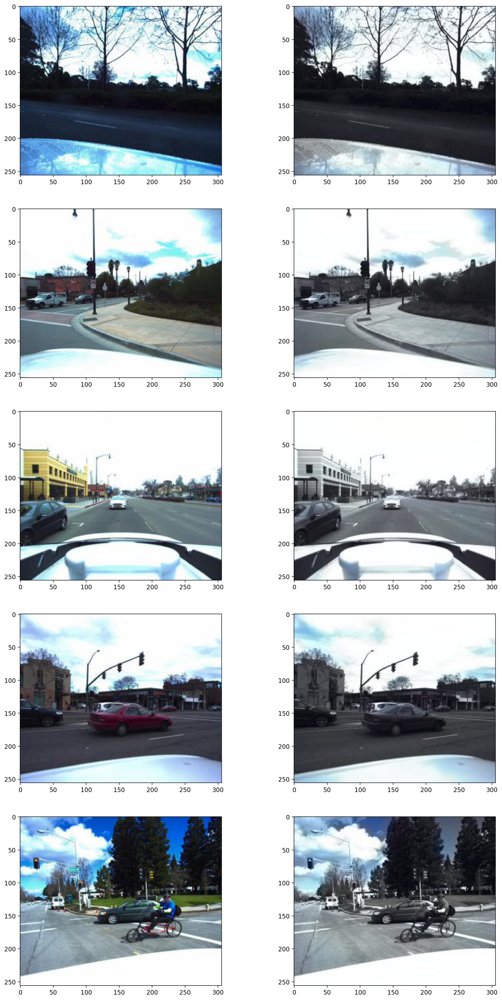

Current training loss is 37.190539
Training iteration 15000 takes 0.074271
Current validatoin loss is 62.155297
Current validation takes 626.662886
Current training loss is 36.410877
Training iteration 15000 takes 0.073705
Current validatoin loss is 58.827503
Current validation takes 623.914264
saving best model
printing test image


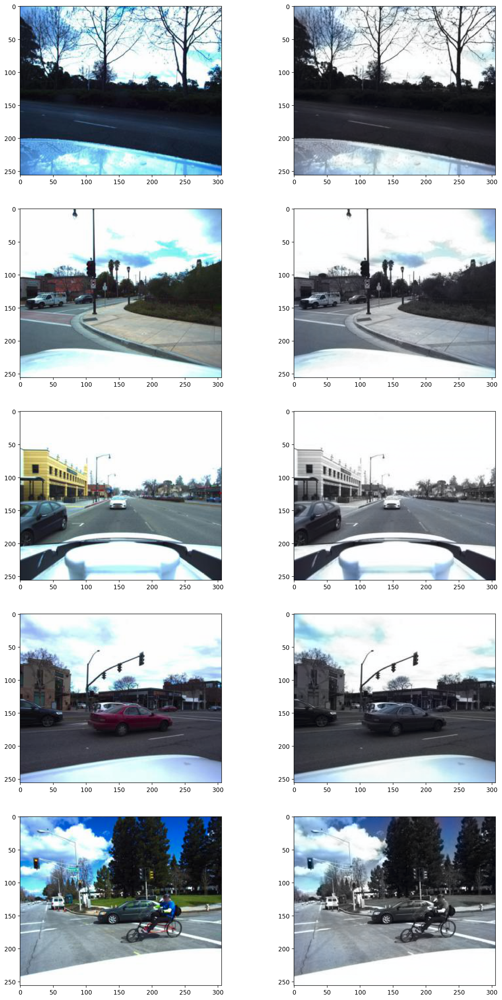

The epoch start is 1588769305.4442594
Current epoch takes 125.135659 min
Epoch 2/3
----------
Current training loss is 34.381312
Training iteration 15000 takes 0.073847
Current validatoin loss is 57.809919
Current validation takes 626.535665
saving best model
Current training loss is 32.868189
Training iteration 15000 takes 0.079003
Current validatoin loss is 55.989414
Current validation takes 596.594402
saving best model
printing test image


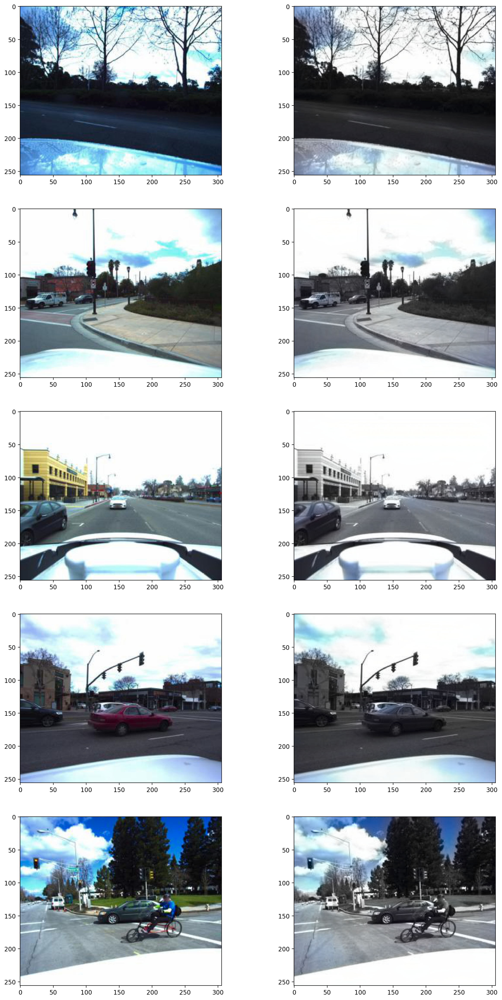

Current training loss is 32.212758
Training iteration 15000 takes 0.073535
Current validatoin loss is 58.201078
Current validation takes 638.634955
Current training loss is 31.059657
Training iteration 15000 takes 0.073456
Current validatoin loss is 61.096323
Current validation takes 663.774119
printing test image


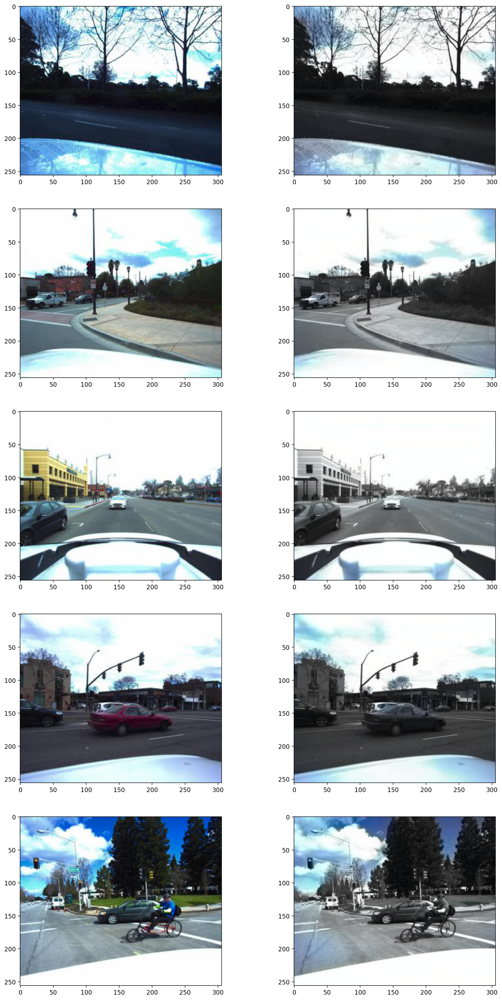

The epoch start is 1588776813.5838034
Current epoch takes 125.448676 min
Epoch 3/3
----------
Current training loss is 29.914074
Training iteration 15000 takes 0.073499
Current validatoin loss is 57.408784
Current validation takes 610.395505
Current training loss is 28.720737
Training iteration 15000 takes 0.073924
Current validatoin loss is 55.324353
Current validation takes 613.219007
saving best model
printing test image


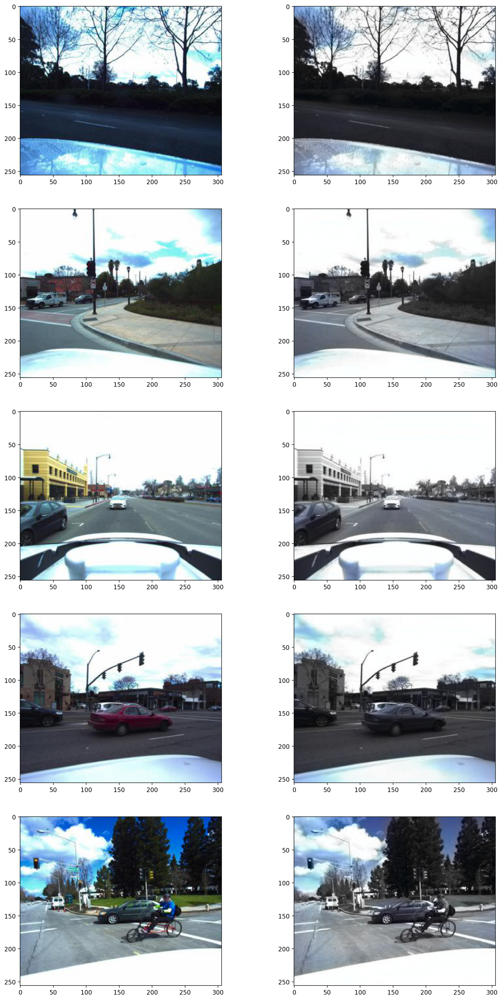

Current training loss is 28.192201
Training iteration 15000 takes 0.073490
Current validatoin loss is 62.506572
Current validation takes 618.689003
Current training loss is 27.956921
Training iteration 15000 takes 0.073663
Current validatoin loss is 57.769470
Current validation takes 633.534373
printing test image


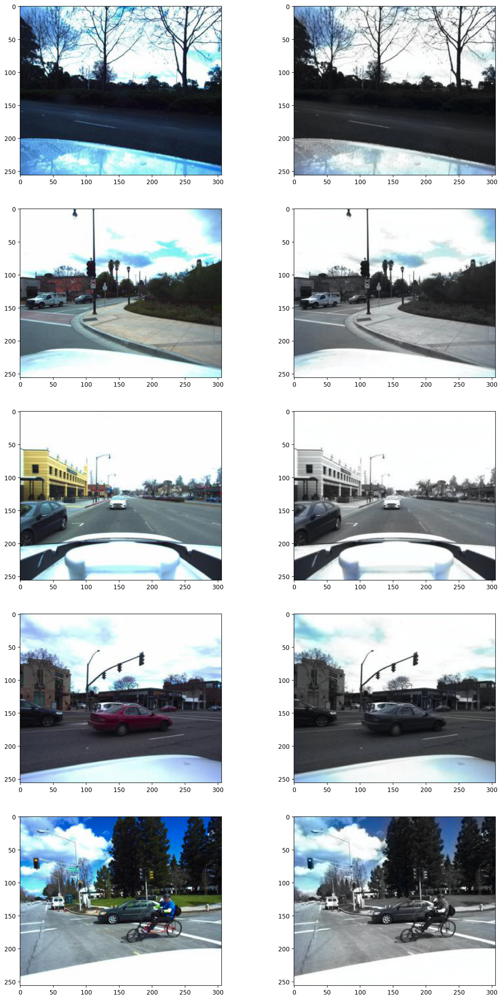

The epoch start is 1588784340.504388
Current epoch takes 124.246665 min


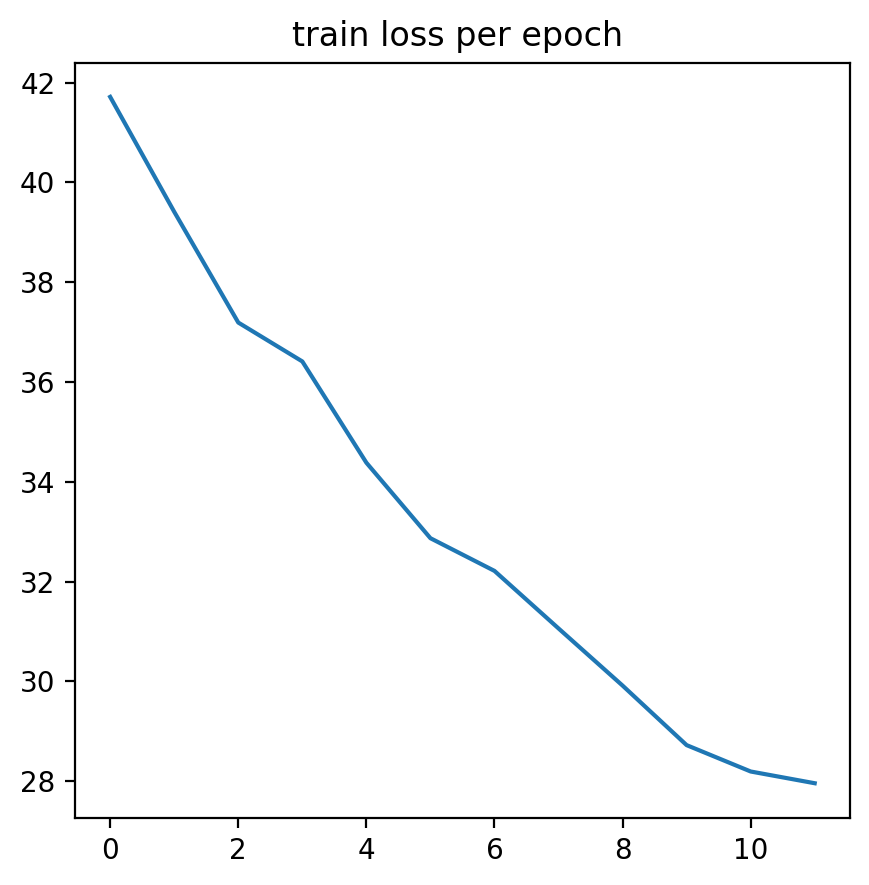

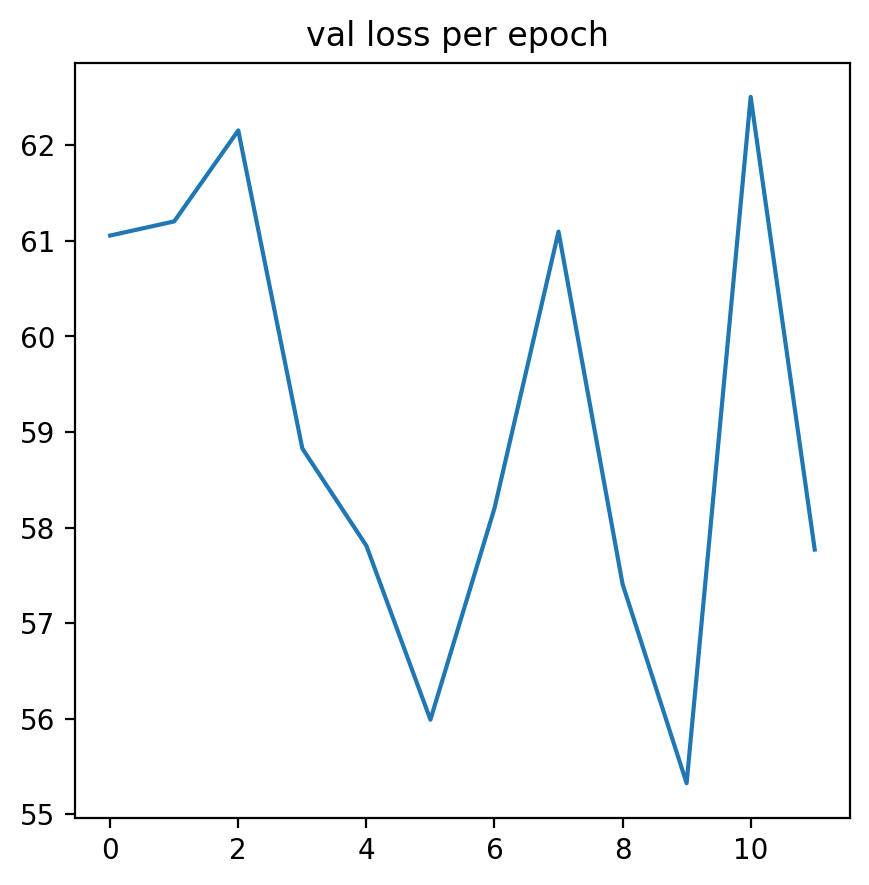

In [12]:
my_model = color_model().to(device)
optimizer = torch.optim.Adam(my_model.parameters(), lr=1e-4)
criterion = nn.MSELoss()

model, loss_dict = train_eval_model(my_model, train_loader, val_loader, criterion, optimizer, 
                                    3, checkpoint='/scratch/ht1162/DLResult/pretrain_colorization.pth', to_save='/scratch/ht1162/DLResult/pretrain_colorization.pth', 
                                    eval_every=15000, print_every = 30000)


loading weights
Epoch 1/3
----------
Current training loss is 27.973676
Training iteration 15000 takes 0.073557
Current validatoin loss is 60.459529
Current validation takes 685.427746
Current training loss is 27.453374
Training iteration 15000 takes 0.098907
Current validatoin loss is 60.034049
Current validation takes 827.891411
printing test image


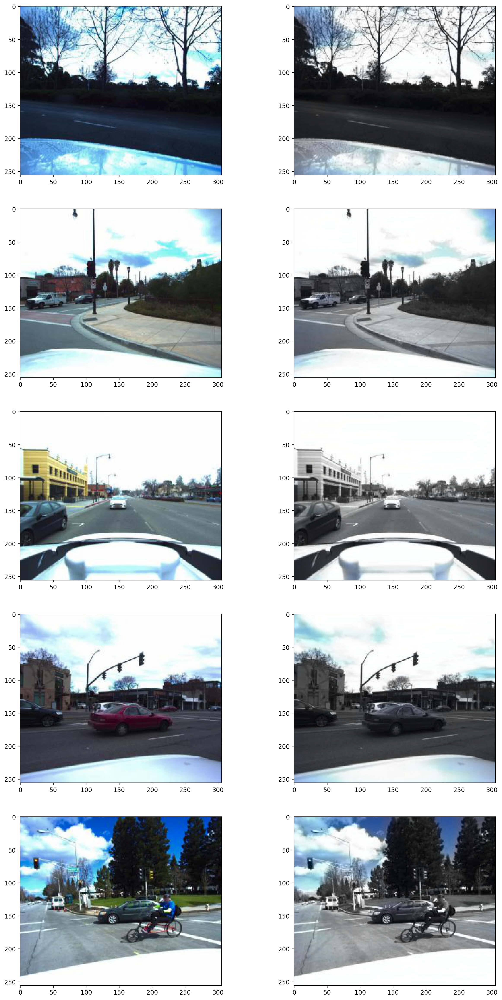

Current training loss is 27.001606
Training iteration 15000 takes 0.077059
Current validatoin loss is 59.124373
Current validation takes 637.743746
Current training loss is 26.447533
Training iteration 15000 takes 0.074478
Current validatoin loss is 56.880890
Current validation takes 626.388516
printing test image


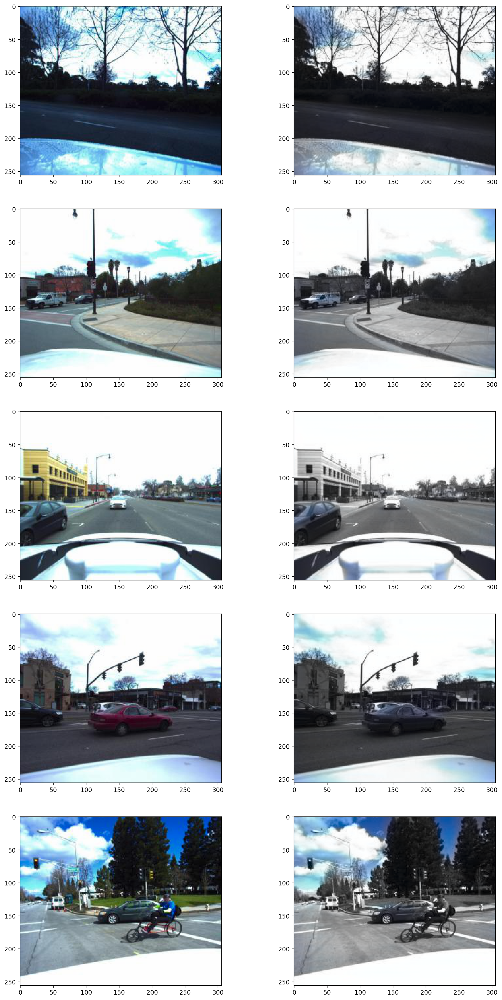

The epoch start is 1588791796.3861866
Current epoch takes 134.683630 min
Epoch 2/3
----------
Current training loss is 25.415416
Training iteration 15000 takes 0.074273
Current validatoin loss is 61.705275
Current validation takes 642.979983
Current training loss is 24.756692
Training iteration 15000 takes 0.074193
Current validatoin loss is 61.928831
Current validation takes 650.381145
printing test image


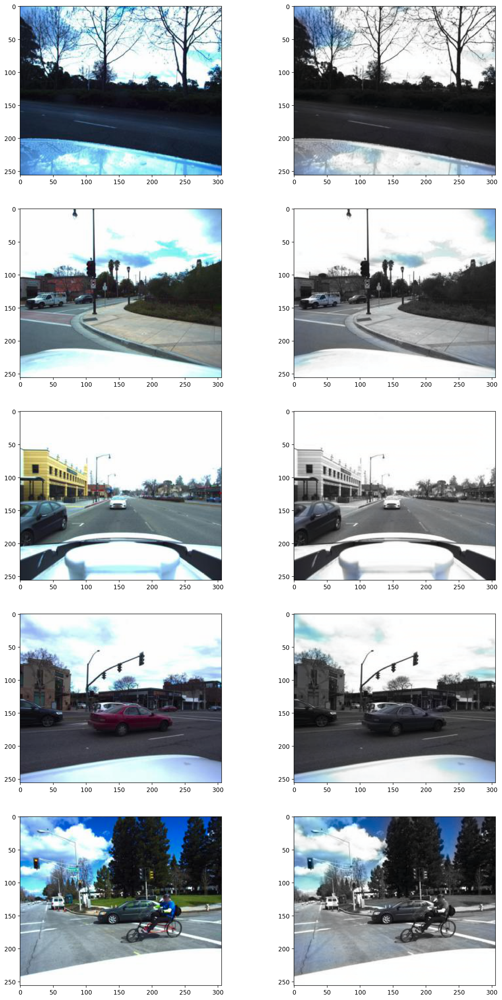

Current training loss is 24.320494
Training iteration 15000 takes 0.074087
Current validatoin loss is 63.839368
Current validation takes 622.319434
Current training loss is 24.653200
Training iteration 15000 takes 0.087191
Current validatoin loss is 60.136142
Current validation takes 802.184108
printing test image


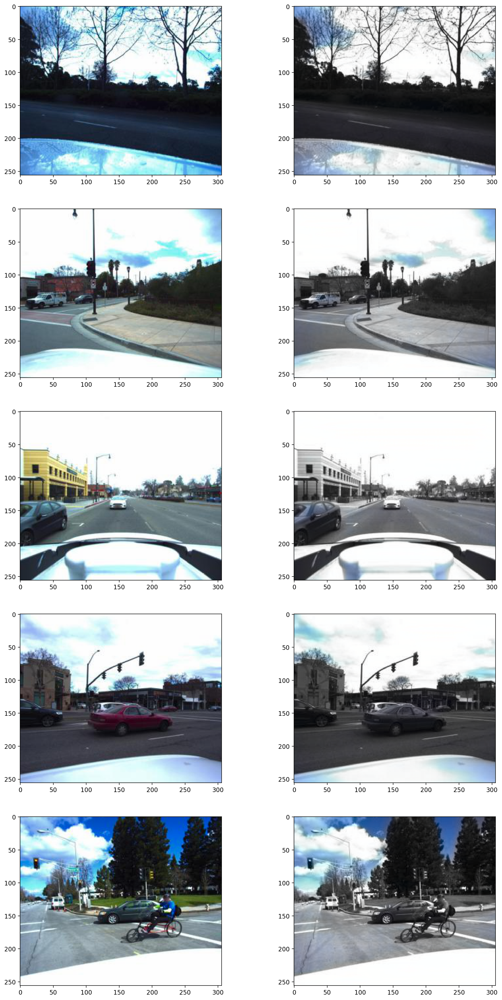

The epoch start is 1588799877.404019
Current epoch takes 133.422821 min
Epoch 3/3
----------
Current training loss is 23.570494
Training iteration 15000 takes 0.073801
Current validatoin loss is 68.039777
Current validation takes 634.655896
Current training loss is 22.497150
Training iteration 15000 takes 0.074595
Current validatoin loss is 56.733328
Current validation takes 642.570905
printing test image


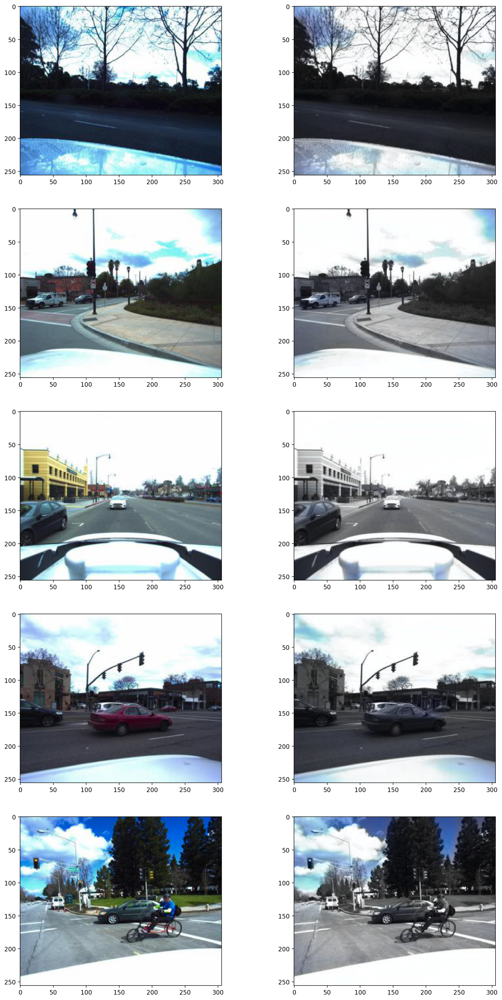

Current training loss is 22.703948
Training iteration 15000 takes 0.075024
Current validatoin loss is 59.083700
Current validation takes 634.357701
Current training loss is 22.560629
Training iteration 15000 takes 0.074396
Current validatoin loss is 61.975261
Current validation takes 637.389418
printing test image


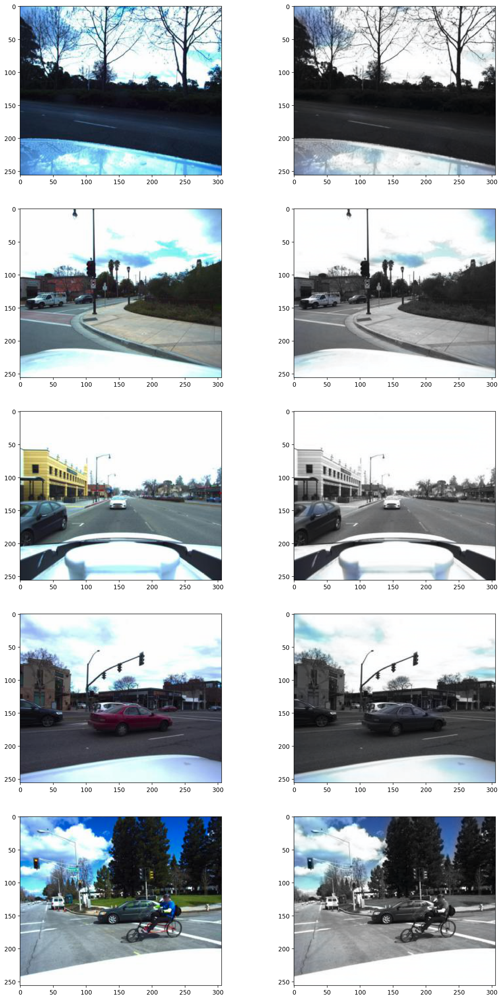

The epoch start is 1588807882.773314
Current epoch takes 126.975075 min


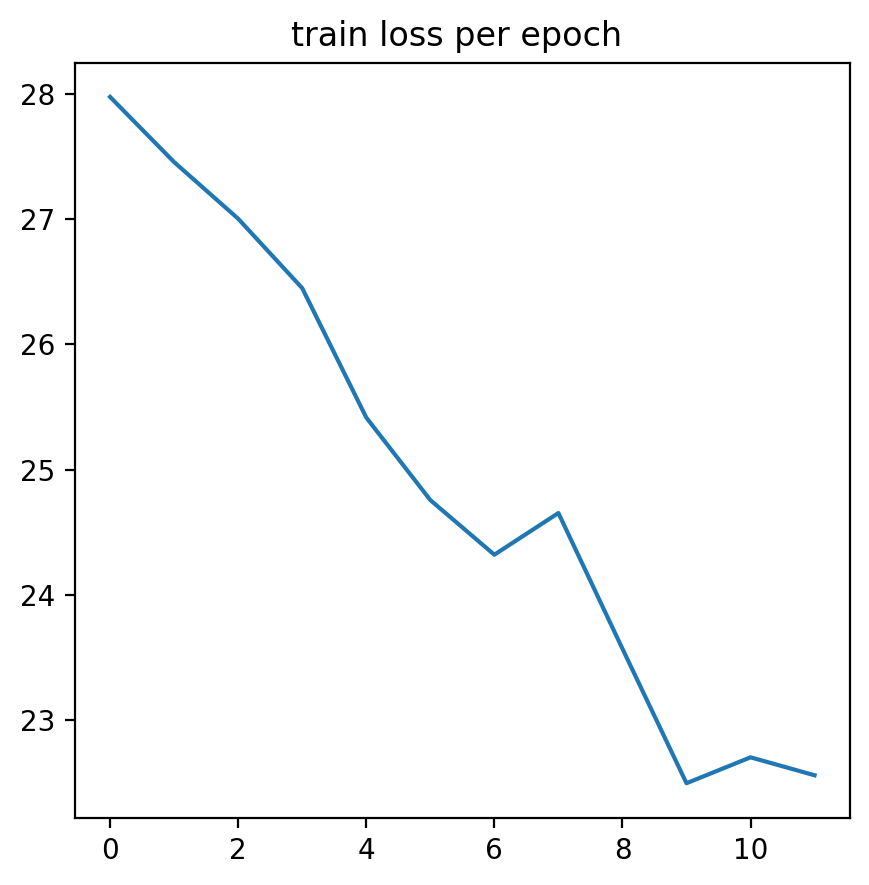

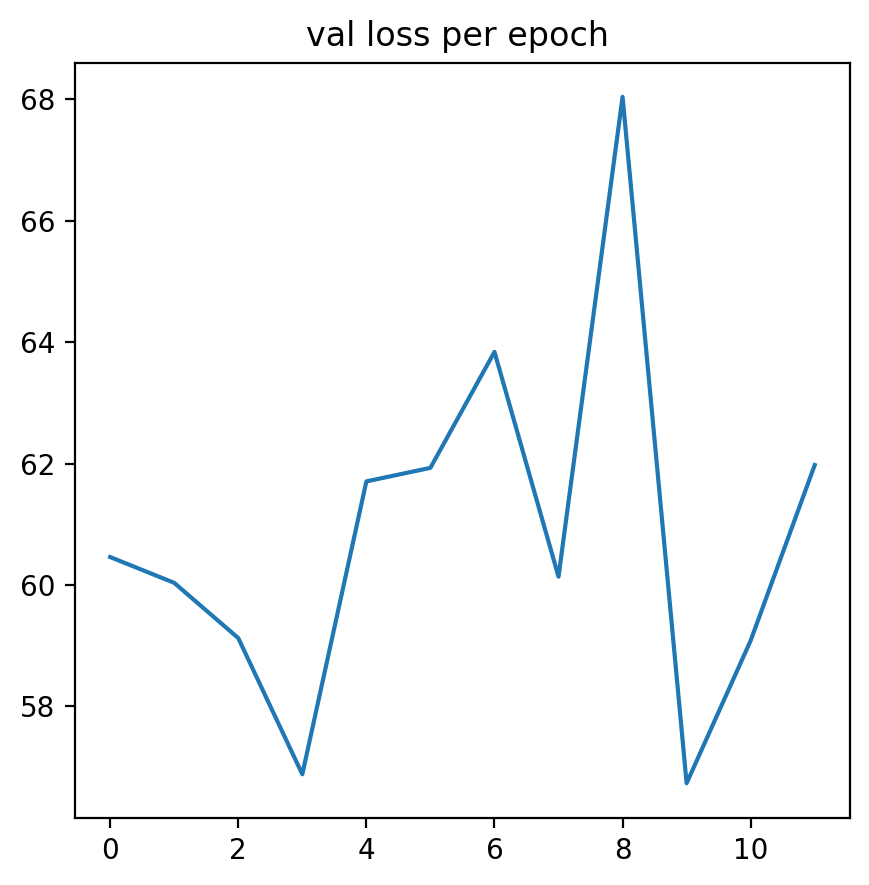

In [13]:
model, loss_dict = train_eval_model(my_model, train_loader, val_loader, criterion, optimizer, 
                                    3, checkpoint='/scratch/ht1162/DLResult/pretrain_colorization.pth', to_save='/scratch/ht1162/DLResult/pretrain_colorization.pth', 
                                    eval_every=15000, print_every = 30000)